# Análisis exploratorio de datos: gasolineras madrileñas

## **1. Variables:**

El conjunto de datos utilizado cuenta con las siguientes variables: 

* **station_id** : Identificador único de la gasolinera
* **name** : Compañia de la gasolinera
* **address** : Dirección
* **town** : Ciudad
* **zip_code** : Código Postal
* **longitude** : Longitud
* **latitude** : Latitud
* **road_side** :(N) Ninguna, (D) Derecha, (I) Izquierda
* **restriction**: (P) Pública, (R) Restringida
* **sender** :(OM) Operador mayorista, (dm) Distribuidor minorista
* **schedule** : Horario de apertura
* **region_id** : Identificador de la región en España
* **province_id** : Identificador de la provincia en España
* **municipality_id** : Identificador de la provincia en España
* **region_name** : Nombre de la región
* **province_name**: Nombre de la provincia
* **municipality_name**: Nombre del municipio
* **date** : Fecha
* **gasoline_95E5** : gasolina 95 E5
* **gasoline_95E5_premium** : gasolina 95 E5 premium
* **gasoline_95E10** : gasolina 95 E10 
* **gasoline_98E5** : gasolina 98 E5 
* **gasoline_98E10** : gasolina 98 E10 
* **diesel_A** :  Diesel A
* **diesel_B** :  Diesel B
* **diesel_premium** :  Diesel premium
* **bioetanol** :  Bioetanol
* **biodiesel** : Biodiesel 
* **lpg** : LPG
* **cng** : CNG
* **lng** : LNG
* **hydrogen** : Hidrógeno

Para poder realizar algunas de las visualizaciones hemos añadido las siguientes variables:

* **vivienda_agua_electricidad_combustibles** : CPI para vivienda, agua, electricidad y combustibles en esa fecha.
* **Precios ajustados** : Hemos ajustado las columnas de precios de combustibles en función de la inflación
* **min_distance** : Distancia a la gasolinera más cercana
* **district** : Distrito de Madrid
* **neighbourhood** : Barrio de Madrid
* **schedule_parsed** : Horario de apertura tipificado
* **name_parsed** : Compañia de la gasolinera tipificado
* **num_combustibles** : Número de combustibles que tienen en la gasolinera.

## **2. Objetivo:**
En este notebook se tratrá de observar la trayectoria de los precios que se tienen de las gasolineras madrileñas junto con otros aspectos importantes para estos.

Los gráficos mostrados se utilizarán posteriormente en el cuadro de mando final. 
   
   * Distribucion de precios (apilado barrios) - dinamico
   * Wordcloud features más repetidas
   * Response time y superhosts
   * Pie chart de los tipos de gasolinera.
   * Tabla: accomodates, beds, bathrooms
   * Occupancy rate (mapa o grafico??)
   * Tabla hosts top10 → % de casas sobre total NY

Todos estos datos serán actualizados con los siguientes filtros que se insertarán en el dashboard final (Dash)
  1. Tipo de combustible
  2. Barrio grande o todo NY
  3. Slider con rango de precios
  4. Nota de reseña

## **3. EDA:**

### Librerías

In [1]:
import json
import math
from itertools import count
from urllib.parse import urlencode
from datetime import datetime, timedelta, date

import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

import pickle

pd.options.display.max_columns = None
pd.options.display.max_rows = 6

### Array de combustibles

In [2]:
# Array de combustibles
products = ["gasoline_95E5",
            "gasoline_95E5_premium",
            "gasoline_98E5",
            "gasoline_98E10",
            "diesel_A",
            "diesel_B",
            "diesel_premium",
            "bioetanol",
            "biodiesel",
            "lpg",
            "cng",
            "lng",
            "hydrogen"]

#Array para los combustibles con el precio ajustado
products_adj = [x + '_adj' for x in products]

### Diccionarios

In [3]:
# Diccionario con los nombres de los combustibles tipificados
products_titles = {
    "gasoline_95E5" : "gasolina 95 E5",
    "gasoline_95E5_premium" : "gasolina 95 E5 premium",
    "gasoline_98E5" : "gasolina 98 E5",
    "gasoline_98E10" : "gasolina 98 E10",
    "diesel_A" : "diesel A",
    "diesel_B" : "diesel B",
    "diesel_premium"  : "diesel premium",
    "bioetanol" : "bioetanol",
    "biodiesel" : "biodiesel",
    "lpg" : "LPG",
    "cng" : "CNG",
    "lng" :"LNG",
    "hydrogen" : "hidrógeno"}

# Diccionario para la paleta de colores en función de la compañia.
name_colors = {
    "OTROS"     : '#%02x%02x%02x' % (89,90,94),
    "BALLENOIL" : '#%02x%02x%02x' % (0,147,203),
    "BP"        : '#%02x%02x%02x' % (17,138,40),
    "CARREFOUR" : '#%02x%02x%02x' % (20,73,146),
    "CEPSA"     : '#%02x%02x%02x' % (199,37,27),
    "GALP"      : '#%02x%02x%02x' % (176,42,12),
    "NATURGY "  : '#%02x%02x%02x' % (210,28,1),
    "PLENOIL"   : '#%02x%02x%02x' % (0,42,104),
    "REPSOL"    : '#%02x%02x%02x' % (253,137,6),
    "SHELL"     : '#%02x%02x%02x' % (251, 199, 11)}

In [4]:
# Array para la paleta de colores en función del combustible.
palette =["#f44336",
          "#e81e63",
          "#9c27b0",
          "#673ab7",
          "#3f51b5",
          "#2196f3",
          "#03a9f4",
          "#00bcd4",
          "#009688",
          "#4caf50",
          "#8bc34a",
          "#cddc39",
          "#ffeb3b"]

### Importar datos procesados y .geojson

In [5]:
# Importamos los datos para cada combustible
with open("data/output/diccionario_df_productos", 'rb') as f:
    dict_df_products = pickle.load(f)
    
# Importamos los datos ya procesados
with open("data/output/df_parsed", 'rb') as f:
    df_parsed = pickle.load(f)
    
# Importamos el .geojson que contiene las coordenadas de los distritos de Madrid
with open('data/raw/madrid-city.geojson', 'r') as f:
    city_border = json.load(f)
    
# Importamos el .geojson que contiene las coordenadas de los barrios de Madrid
with open('data/raw/madrid-neighbourhoods.geojson', 'r') as f:
    neighbourhood_borders = json.load(f)
    
# Importamos el .csv que contiene los nombres de los barrios de Madrid    
neighbourhood_names = pd.read_csv('data/raw/madrid-neighbourhoods-names.csv')

### Comprobamos los datos importados

In [6]:
for product in products:
    print(product + ":")
    display(dict_df_products[product])

gasoline_95E5:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
0,2909,2022-01-02,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.43900,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
1,2909,2022-01-03,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.43900,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
2,2909,2022-01-04,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.43900,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3026,15166,2022-01-12,PLENOIL,"CALLE SAN DALMACIO, 13",28000,-3.694917,40.34325,D,P,dm,L-D: 24H,1.387,0.0,0.0,0.000,0.0,1.257,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.387,0.0,0.000,0.0,1.257,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.753233,Villaverde,"Villaverde Alto, Casco Histórico de Villaverde",24H,PLENOIL,13
3027,15166,2022-01-13,PLENOIL,"CALLE SAN DALMACIO, 13",28000,-3.694917,40.34325,D,P,dm,L-D: 24H,1.397,0.0,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.397,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.753233,Villaverde,"Villaverde Alto, Casco Histórico de Villaverde",24H,PLENOIL,13
3028,15166,2022-01-14,PLENOIL,"CALLE SAN DALMACIO, 13",28000,-3.694917,40.34325,D,P,dm,L-D: 24H,1.397,0.0,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.397,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.753233,Villaverde,"Villaverde Alto, Casco Histórico de Villaverde",24H,PLENOIL,13


gasoline_95E5_premium:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
39,2914,2022-01-02,REPSOL,"CR N-4 P.K. 6,70 I",28041,-3.693833,40.367000,I,P,dm,L-D: 24H,1.529,1.559,0.0,1.679,0.0,1.409,0.0,1.439,0.0,0.0,0.000,0.0,0.0,0.0,112.574,1.529,1.559,1.679,0.0,1.409,0.0,1.439,0.0,0.0,0.000,0.0,0.0,0.0,0.089878,Usera,San Fermín,24H,REPSOL,13
40,2914,2022-01-03,REPSOL,"CR N-4 P.K. 6,70 I",28041,-3.693833,40.367000,I,P,dm,L-D: 24H,1.529,1.559,0.0,1.679,0.0,1.409,0.0,1.439,0.0,0.0,0.000,0.0,0.0,0.0,112.574,1.529,1.559,1.679,0.0,1.409,0.0,1.439,0.0,0.0,0.000,0.0,0.0,0.0,0.089878,Usera,San Fermín,24H,REPSOL,13
41,2914,2022-01-04,REPSOL,"CR N-4 P.K. 6,70 I",28041,-3.693833,40.367000,I,P,dm,L-D: 24H,1.529,1.559,0.0,1.679,0.0,1.409,0.0,1.439,0.0,0.0,0.000,0.0,0.0,0.0,112.574,1.529,1.559,1.679,0.0,1.409,0.0,1.439,0.0,0.0,0.000,0.0,0.0,0.0,0.089878,Usera,San Fermín,24H,REPSOL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2168,11538,2022-01-12,REPSOL,"CALLE ABETAL, 8",28050,-3.661944,40.501389,D,P,OM,L-D: 24H,1.579,1.599,0.0,1.719,0.0,1.469,0.0,1.559,0.0,0.0,0.849,0.0,0.0,0.0,112.574,1.579,1.599,1.719,0.0,1.469,0.0,1.559,0.0,0.0,0.849,0.0,0.0,0.0,0.423080,Fuencarral-El Pardo,Valverde,24H,REPSOL,13
2169,11538,2022-01-13,REPSOL,"CALLE ABETAL, 8",28050,-3.661944,40.501389,D,P,OM,L-D: 24H,1.595,1.615,0.0,1.735,0.0,1.479,0.0,1.569,0.0,0.0,0.849,0.0,0.0,0.0,112.574,1.595,1.615,1.735,0.0,1.479,0.0,1.569,0.0,0.0,0.849,0.0,0.0,0.0,0.423080,Fuencarral-El Pardo,Valverde,24H,REPSOL,13
2170,11538,2022-01-14,REPSOL,"CALLE ABETAL, 8",28050,-3.661944,40.501389,D,P,OM,L-D: 24H,1.599,1.619,0.0,1.749,0.0,1.489,0.0,1.589,0.0,0.0,0.849,0.0,0.0,0.0,112.574,1.599,1.619,1.749,0.0,1.489,0.0,1.589,0.0,0.0,0.849,0.0,0.0,0.0,0.423080,Fuencarral-El Pardo,Valverde,24H,REPSOL,13


gasoline_98E5:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
0,2909,2022-01-02,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.439000,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
1,2909,2022-01-03,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.439000,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
2,2909,2022-01-04,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.439000,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3000,15107,2022-01-12,BP MAYORAZGO 365,"CALLE SIERRA DE LA DEMANDA, 2",28031,-3.633750,40.370111,I,P,dm,L-D: 24H,1.489,0.0,0.0,1.609,0.0,1.409,0.0,1.459,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.489,0.0,1.609,0.0,1.409,0.0,1.459,0.0,0.0,0.0,0.0,0.0,0.0,0.314062,Villa de Vallecas,Casco Histórico de Vallecas,24H,BP,13
3001,15107,2022-01-13,BP MAYORAZGO 365,"CALLE SIERRA DE LA DEMANDA, 2",28031,-3.633750,40.370111,I,P,dm,L-D: 24H,1.499,0.0,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.499,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,0.314062,Villa de Vallecas,Casco Histórico de Vallecas,24H,BP,13
3002,15107,2022-01-14,BP MAYORAZGO 365,"CALLE SIERRA DE LA DEMANDA, 2",28031,-3.633750,40.370111,I,P,dm,L-D: 24H,1.499,0.0,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.499,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,0.314062,Villa de Vallecas,Casco Histórico de Vallecas,24H,BP,13


gasoline_98E10:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles


diesel_A:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
0,2909,2022-01-02,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.43900,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
1,2909,2022-01-03,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.43900,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
2,2909,2022-01-04,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.43900,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3026,15166,2022-01-12,PLENOIL,"CALLE SAN DALMACIO, 13",28000,-3.694917,40.34325,D,P,dm,L-D: 24H,1.387,0.0,0.0,0.000,0.0,1.257,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.387,0.0,0.000,0.0,1.257,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.753233,Villaverde,"Villaverde Alto, Casco Histórico de Villaverde",24H,PLENOIL,13
3027,15166,2022-01-13,PLENOIL,"CALLE SAN DALMACIO, 13",28000,-3.694917,40.34325,D,P,dm,L-D: 24H,1.397,0.0,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.397,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.753233,Villaverde,"Villaverde Alto, Casco Histórico de Villaverde",24H,PLENOIL,13
3028,15166,2022-01-14,PLENOIL,"CALLE SAN DALMACIO, 13",28000,-3.694917,40.34325,D,P,dm,L-D: 24H,1.397,0.0,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.397,0.0,0.000,0.0,1.267,0.0,0.000,0.0,0.0,0.0,0.0,0.0,0.0,0.753233,Villaverde,"Villaverde Alto, Casco Histórico de Villaverde",24H,PLENOIL,13


diesel_B:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
130,3143,2022-01-02,REPSOL,"CARRETERA M-301 KM. 3,5",28053,-3.655667,40.366333,I,P,dm,L-D: 24H,1.549,0.0,0.0,1.699,0.0,1.439,1.047,1.499,0.0,0.0,0.000,0.0,0.0,0.0,112.574,1.549,0.0,1.699,0.0,1.439,1.047,1.499,0.0,0.0,0.000,0.0,0.0,0.0,0.271515,Villa de Vallecas,Casco Histórico de Vallecas,24H,REPSOL,13
131,3143,2022-01-03,REPSOL,"CARRETERA M-301 KM. 3,5",28053,-3.655667,40.366333,I,P,dm,L-D: 24H,1.549,0.0,0.0,1.699,0.0,1.439,1.047,1.499,0.0,0.0,0.000,0.0,0.0,0.0,112.574,1.549,0.0,1.699,0.0,1.439,1.047,1.499,0.0,0.0,0.000,0.0,0.0,0.0,0.271515,Villa de Vallecas,Casco Histórico de Vallecas,24H,REPSOL,13
132,3143,2022-01-04,REPSOL,"CARRETERA M-301 KM. 3,5",28053,-3.655667,40.366333,I,P,dm,L-D: 24H,1.549,0.0,0.0,1.699,0.0,1.429,1.047,1.489,0.0,0.0,0.000,0.0,0.0,0.0,112.574,1.549,0.0,1.699,0.0,1.429,1.047,1.489,0.0,0.0,0.000,0.0,0.0,0.0,0.271515,Villa de Vallecas,Casco Histórico de Vallecas,24H,REPSOL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2545,13434,2022-01-12,CEPSA VALLECAS-LA ATALAYUELA 365,CARRETERA VILLAVERDE A VALLECAS KM. 248,28031,-3.644944,40.369778,I,P,dm,L-D: 24H,1.559,0.0,0.0,1.669,0.0,1.429,0.999,1.479,0.0,0.0,0.799,0.0,0.0,0.0,112.574,1.559,0.0,1.669,0.0,1.429,0.999,1.479,0.0,0.0,0.799,0.0,0.0,0.0,0.077783,Villa de Vallecas,Casco Histórico de Vallecas,24H,CEPSA,13
2546,13434,2022-01-13,CEPSA VALLECAS-LA ATALAYUELA 365,CARRETERA VILLAVERDE A VALLECAS KM. 248,28031,-3.644944,40.369778,I,P,dm,L-D: 24H,1.569,0.0,0.0,1.679,0.0,1.439,0.999,1.489,0.0,0.0,0.799,0.0,0.0,0.0,112.574,1.569,0.0,1.679,0.0,1.439,0.999,1.489,0.0,0.0,0.799,0.0,0.0,0.0,0.077783,Villa de Vallecas,Casco Histórico de Vallecas,24H,CEPSA,13
2547,13434,2022-01-14,CEPSA VALLECAS-LA ATALAYUELA 365,CARRETERA VILLAVERDE A VALLECAS KM. 248,28031,-3.644944,40.369778,I,P,dm,L-D: 24H,1.569,0.0,0.0,1.679,0.0,1.439,1.029,1.489,0.0,0.0,0.799,0.0,0.0,0.0,112.574,1.569,0.0,1.679,0.0,1.439,1.029,1.489,0.0,0.0,0.799,0.0,0.0,0.0,0.077783,Villa de Vallecas,Casco Histórico de Vallecas,24H,CEPSA,13


diesel_premium:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
0,2909,2022-01-02,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.439000,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
1,2909,2022-01-03,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.439000,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.429,0.0,1.489,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
2,2909,2022-01-04,REPSOL,"CALLE CEA BERMUDEZ, 32",28003,-3.709639,40.439000,D,P,dm,L-D: 24H,1.569,0.0,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.569,0.0,1.719,0.0,1.439,0.0,1.499,0.0,0.0,0.0,0.0,0.0,0.0,0.508705,Chamberi,Vallehermoso,24H,REPSOL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3000,15107,2022-01-12,BP MAYORAZGO 365,"CALLE SIERRA DE LA DEMANDA, 2",28031,-3.633750,40.370111,I,P,dm,L-D: 24H,1.489,0.0,0.0,1.609,0.0,1.409,0.0,1.459,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.489,0.0,1.609,0.0,1.409,0.0,1.459,0.0,0.0,0.0,0.0,0.0,0.0,0.314062,Villa de Vallecas,Casco Histórico de Vallecas,24H,BP,13
3001,15107,2022-01-13,BP MAYORAZGO 365,"CALLE SIERRA DE LA DEMANDA, 2",28031,-3.633750,40.370111,I,P,dm,L-D: 24H,1.499,0.0,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.499,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,0.314062,Villa de Vallecas,Casco Histórico de Vallecas,24H,BP,13
3002,15107,2022-01-14,BP MAYORAZGO 365,"CALLE SIERRA DE LA DEMANDA, 2",28031,-3.633750,40.370111,I,P,dm,L-D: 24H,1.499,0.0,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,112.574,1.499,0.0,1.619,0.0,1.419,0.0,1.469,0.0,0.0,0.0,0.0,0.0,0.0,0.314062,Villa de Vallecas,Casco Histórico de Vallecas,24H,BP,13


bioetanol:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles


biodiesel:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
2106,11445,2022-01-02,SHELL,"CALLE SANTO DOMINGO, 10",28000,-3.679083,40.508056,D,P,OM,L-D: 24H,1.564,0.0,0.0,1.704,0.0,1.429,0.0,1.509,0.0,1.704,0.819,0.0,0.0,0.0,112.574,1.564,0.0,1.704,0.0,1.429,0.0,1.509,0.0,1.704,0.819,0.0,0.0,0.0,0.860319,Fuencarral-El Pardo,Valverde,24H,SHELL,13
2107,11445,2022-01-03,SHELL,"CALLE SANTO DOMINGO, 10",28000,-3.679083,40.508056,D,P,OM,L-D: 24H,1.569,0.0,0.0,1.709,0.0,1.439,0.0,1.519,0.0,1.709,0.819,0.0,0.0,0.0,112.574,1.569,0.0,1.709,0.0,1.439,0.0,1.519,0.0,1.709,0.819,0.0,0.0,0.0,0.860319,Fuencarral-El Pardo,Valverde,24H,SHELL,13
2108,11445,2022-01-04,SHELL,"CALLE SANTO DOMINGO, 10",28000,-3.679083,40.508056,D,P,OM,L-D: 24H,1.579,0.0,0.0,1.719,0.0,1.449,0.0,1.529,0.0,1.719,0.819,0.0,0.0,0.0,112.574,1.579,0.0,1.719,0.0,1.449,0.0,1.529,0.0,1.719,0.819,0.0,0.0,0.0,0.860319,Fuencarral-El Pardo,Valverde,24H,SHELL,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2116,11445,2022-01-12,SHELL,"CALLE SANTO DOMINGO, 10",28000,-3.679083,40.508056,D,P,OM,L-D: 24H,1.579,0.0,0.0,1.719,0.0,1.469,0.0,1.549,0.0,1.719,0.799,0.0,0.0,0.0,112.574,1.579,0.0,1.719,0.0,1.469,0.0,1.549,0.0,1.719,0.799,0.0,0.0,0.0,0.860319,Fuencarral-El Pardo,Valverde,24H,SHELL,13
2117,11445,2022-01-13,SHELL,"CALLE SANTO DOMINGO, 10",28000,-3.679083,40.508056,D,P,OM,L-D: 24H,1.589,0.0,0.0,1.729,0.0,1.479,0.0,1.559,0.0,1.729,0.799,0.0,0.0,0.0,112.574,1.589,0.0,1.729,0.0,1.479,0.0,1.559,0.0,1.729,0.799,0.0,0.0,0.0,0.860319,Fuencarral-El Pardo,Valverde,24H,SHELL,13
2118,11445,2022-01-14,SHELL,"CALLE SANTO DOMINGO, 10",28000,-3.679083,40.508056,D,P,OM,L-D: 24H,1.599,0.0,0.0,1.739,0.0,1.489,0.0,1.569,0.0,1.739,0.799,0.0,0.0,0.0,112.574,1.599,0.0,1.739,0.0,1.489,0.0,1.569,0.0,1.739,0.799,0.0,0.0,0.0,0.860319,Fuencarral-El Pardo,Valverde,24H,SHELL,13


lpg:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
65,3065,2022-01-02,GALP,"AVENIDA DE LOS POBLADOS, SN",28025,-3.743028,40.373500,N,P,OM,L-D: 06:00-22:00,1.479,0.0,0.0,1.619,0.0,1.349,0.0,1.379,0.0,0.0,0.839,0.0,0.0,0.0,112.574,1.479,0.0,1.619,0.0,1.349,0.0,1.379,0.0,0.0,0.839,0.0,0.0,0.0,0.202959,Carabanchel,Puerta Bonita,L-D,GALP,13
66,3065,2022-01-03,GALP,"AVENIDA DE LOS POBLADOS, SN",28025,-3.743028,40.373500,N,P,OM,L-D: 06:00-22:00,1.479,0.0,0.0,1.619,0.0,1.349,0.0,1.379,0.0,0.0,0.839,0.0,0.0,0.0,112.574,1.479,0.0,1.619,0.0,1.349,0.0,1.379,0.0,0.0,0.839,0.0,0.0,0.0,0.202959,Carabanchel,Puerta Bonita,L-D,GALP,13
67,3065,2022-01-04,GALP,"AVENIDA DE LOS POBLADOS, SN",28025,-3.743028,40.373500,N,P,OM,L-D: 06:00-22:00,1.489,0.0,0.0,1.629,0.0,1.379,0.0,1.409,0.0,0.0,0.799,0.0,0.0,0.0,112.574,1.489,0.0,1.629,0.0,1.379,0.0,1.409,0.0,0.0,0.799,0.0,0.0,0.0,0.202959,Carabanchel,Puerta Bonita,L-D,GALP,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2844,14773,2022-01-12,MADRID WETAXI GLP,"CALLE ISAAC JIMENEZ, 3",28037,-3.629889,40.436528,D,P,dm,L-D: 24H,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.729,0.0,0.0,0.0,112.574,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.729,0.0,0.0,0.0,0.614522,San Blas,Simancas,24H,OTROS,13
2845,14773,2022-01-13,MADRID WETAXI GLP,"CALLE ISAAC JIMENEZ, 3",28037,-3.629889,40.436528,D,P,dm,L-D: 24H,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.729,0.0,0.0,0.0,112.574,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.729,0.0,0.0,0.0,0.614522,San Blas,Simancas,24H,OTROS,13
2846,14773,2022-01-14,MADRID WETAXI GLP,"CALLE ISAAC JIMENEZ, 3",28037,-3.629889,40.436528,D,P,dm,L-D: 24H,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.729,0.0,0.0,0.0,112.574,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.729,0.0,0.0,0.0,0.614522,San Blas,Simancas,24H,OTROS,13


cng:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
117,3133,2022-01-02,CEPSA,"M-40, PK 7.4 - ACCESO AL CAMPO DE LAS NACIONES, 2",28042,-3.616139,40.458417,I,P,dm,L-D: 24H,1.549,0.0,0.0,1.681,0.0,1.419,0.0,1.485,0.0,0.0,0.889,1.199,0.0,0.0,112.574,1.549,0.0,1.681,0.0,1.419,0.0,1.485,0.0,0.0,0.889,1.199,0.0,0.0,1.483725,Hortaleza,Corralejos,24H,CEPSA,13
118,3133,2022-01-03,CEPSA,"M-40, PK 7.4 - ACCESO AL CAMPO DE LAS NACIONES, 2",28042,-3.616139,40.458417,I,P,dm,L-D: 24H,1.549,0.0,0.0,1.681,0.0,1.419,0.0,1.485,0.0,0.0,0.889,1.199,0.0,0.0,112.574,1.549,0.0,1.681,0.0,1.419,0.0,1.485,0.0,0.0,0.889,1.199,0.0,0.0,1.483725,Hortaleza,Corralejos,24H,CEPSA,13
119,3133,2022-01-04,CEPSA,"M-40, PK 7.4 - ACCESO AL CAMPO DE LAS NACIONES, 2",28042,-3.616139,40.458417,I,P,dm,L-D: 24H,1.549,0.0,0.0,1.681,0.0,1.419,0.0,1.485,0.0,0.0,0.889,1.199,0.0,0.0,112.574,1.549,0.0,1.681,0.0,1.419,0.0,1.485,0.0,0.0,0.889,1.199,0.0,0.0,1.483725,Hortaleza,Corralejos,24H,CEPSA,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2740,14360,2022-01-12,ALIARA ENERGIA,"CALLE PORTOMARIN, 25",28050,-3.669944,40.513194,D,P,dm,L-D: 24H,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.000,1.950,0.0,0.0,112.574,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.000,1.950,0.0,0.0,1.160636,Fuencarral-El Pardo,Valverde,24H,OTROS,13
2741,14360,2022-01-13,ALIARA ENERGIA,"CALLE PORTOMARIN, 25",28050,-3.669944,40.513194,D,P,dm,L-D: 24H,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.000,1.950,0.0,0.0,112.574,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.000,1.950,0.0,0.0,1.160636,Fuencarral-El Pardo,Valverde,24H,OTROS,13
2742,14360,2022-01-14,ALIARA ENERGIA,"CALLE PORTOMARIN, 25",28050,-3.669944,40.513194,D,P,dm,L-D: 24H,0.000,0.0,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.000,1.950,0.0,0.0,112.574,0.000,0.0,0.000,0.0,0.000,0.0,0.000,0.0,0.0,0.000,1.950,0.0,0.0,1.160636,Fuencarral-El Pardo,Valverde,24H,OTROS,13


lng:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles
2522,13334,2022-01-02,HAM TRES CANTOS,"CARRETERA M-607 KM. 17,7",28049,-3.710556,40.562417,D,P,dm,L-D: 24H,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.19,1.11,0.0,112.574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.19,1.11,0.0,0.015749,Fuencarral-El Pardo,El Goloso,24H,OTROS,13
2523,13334,2022-01-03,HAM TRES CANTOS,"CARRETERA M-607 KM. 17,7",28049,-3.710556,40.562417,D,P,dm,L-D: 24H,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.19,1.11,0.0,112.574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.19,1.11,0.0,0.015749,Fuencarral-El Pardo,El Goloso,24H,OTROS,13
2524,13334,2022-01-04,HAM TRES CANTOS,"CARRETERA M-607 KM. 17,7",28049,-3.710556,40.562417,D,P,dm,L-D: 24H,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.19,1.11,0.0,112.574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.19,1.11,0.0,0.015749,Fuencarral-El Pardo,El Goloso,24H,OTROS,13
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2532,13334,2022-01-12,HAM TRES CANTOS,"CARRETERA M-607 KM. 17,7",28049,-3.710556,40.562417,D,P,dm,L-D: 24H,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.99,1.89,0.0,112.574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.99,1.89,0.0,0.015749,Fuencarral-El Pardo,El Goloso,24H,OTROS,13
2533,13334,2022-01-13,HAM TRES CANTOS,"CARRETERA M-607 KM. 17,7",28049,-3.710556,40.562417,D,P,dm,L-D: 24H,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.99,1.89,0.0,112.574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.99,1.89,0.0,0.015749,Fuencarral-El Pardo,El Goloso,24H,OTROS,13
2534,13334,2022-01-14,HAM TRES CANTOS,"CARRETERA M-607 KM. 17,7",28049,-3.710556,40.562417,D,P,dm,L-D: 24H,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.99,1.89,0.0,112.574,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.99,1.89,0.0,0.015749,Fuencarral-El Pardo,El Goloso,24H,OTROS,13


hydrogen:


,station_id,date,name,address,zip_code,longitude,latitude,road_side,restriction,sender,schedule,gasoline_95E5,gasoline_95E5_premium,gasoline_95E10,gasoline_98E5,gasoline_98E10,diesel_A,diesel_B,diesel_premium,bioetanol,biodiesel,lpg,cng,lng,hydrogen,vivienda_agua_electricidad_combustibles,gasoline_95E5_adj,gasoline_95E5_premium_adj,gasoline_98E5_adj,gasoline_98E10_adj,diesel_A_adj,diesel_B_adj,diesel_premium_adj,bioetanol_adj,biodiesel_adj,lpg_adj,cng_adj,lng_adj,hydrogen_adj,min_distance,district,neighbourhood,schedule_parsed,name_parsed,num_combustibles


### Gráfico de líneas de cada combustibles

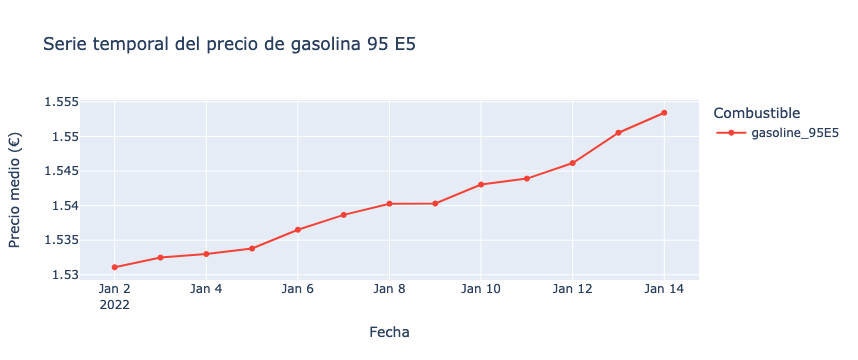

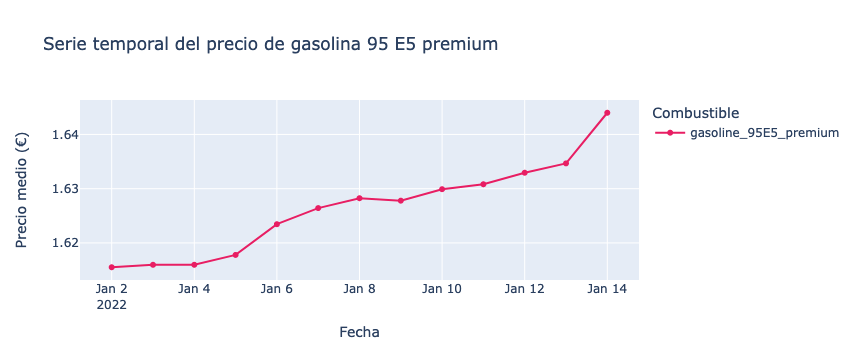

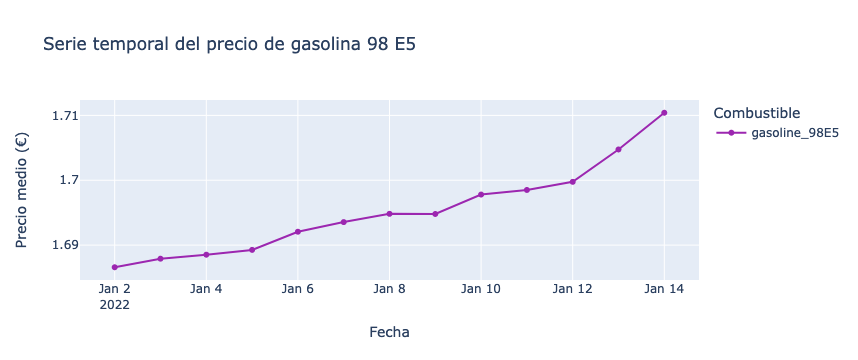

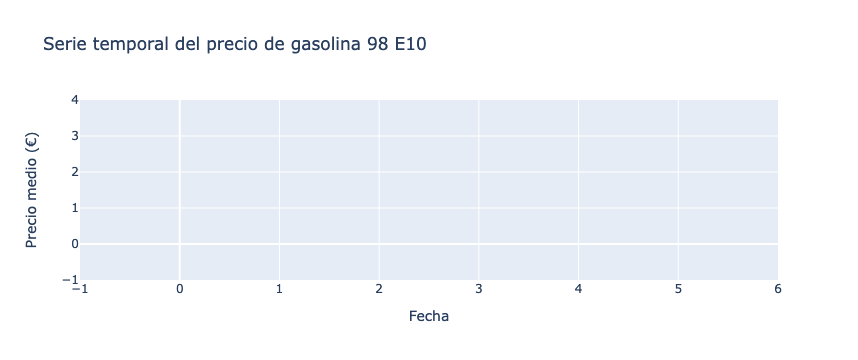

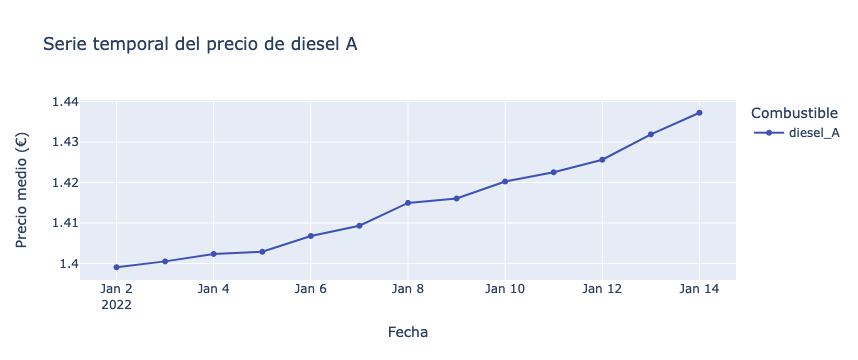

...

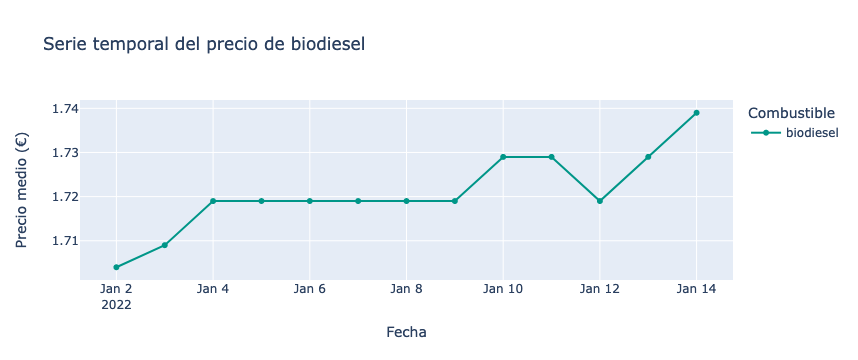

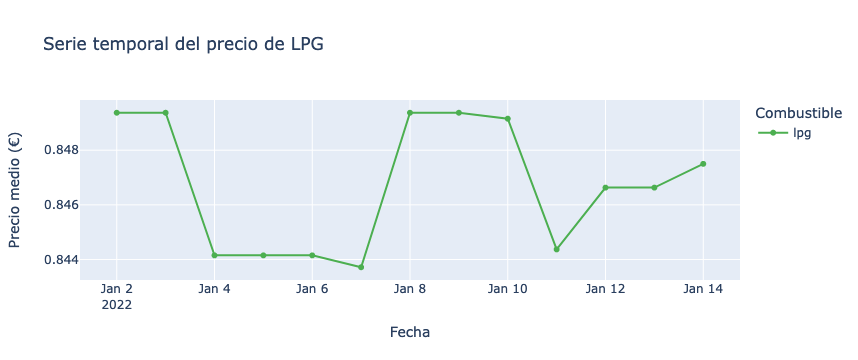

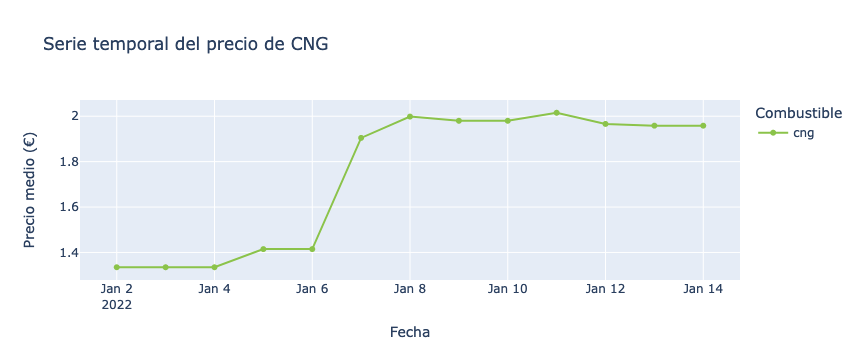

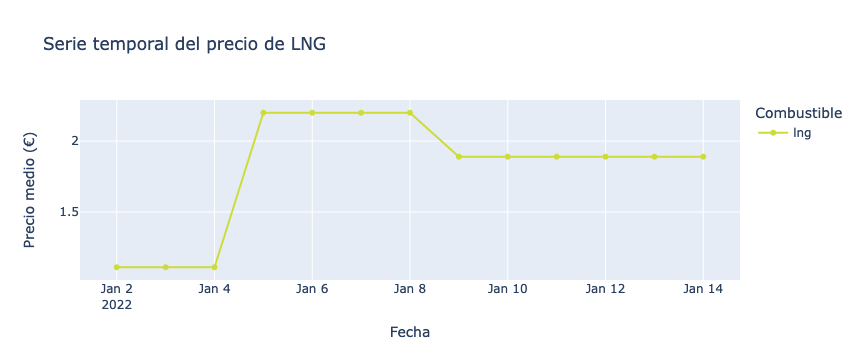

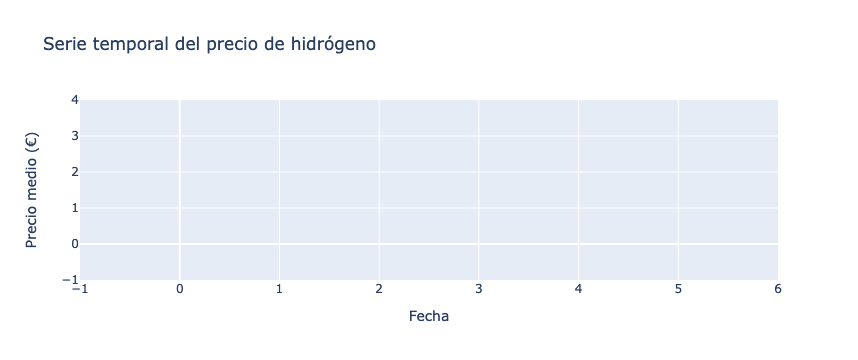

In [7]:
i=0
for product in products:
    df_lineas = dict_df_products[product][['date', product]]
    #Realizamos una media por fecha del precio del combustible en todas las gasolineras.
    df_lineas = df_lineas.groupby(['date'], group_keys = True).mean().reset_index() 

    fig = px.line(df_lineas, 
                  x = 'date', 
                  y = [product], 
                  color_discrete_sequence = [palette[i]], 
                  labels = {
                    "value": "Precio medio (€)",
                    "date": "Fecha",
                    "variable": "Combustible"
                  },
                  title = 'Serie temporal del precio de '+ products_titles[product])
    
    fig.update_traces(mode = "markers+lines", hovertemplate=None)
    fig.update_layout(hovermode = "x")
    
    fig.show()
    i=i+1


### Gráfico de líneas de la evolución de los precios de los combustibles

In [8]:
df_lineas = df_parsed[['date']+products].replace(0, np.nan)

df_lineas = df_lineas.groupby(['date'], group_keys=True).mean().reset_index()



### Gráfico de líneas de la comparativa entre precios ajustados y sin ajustar

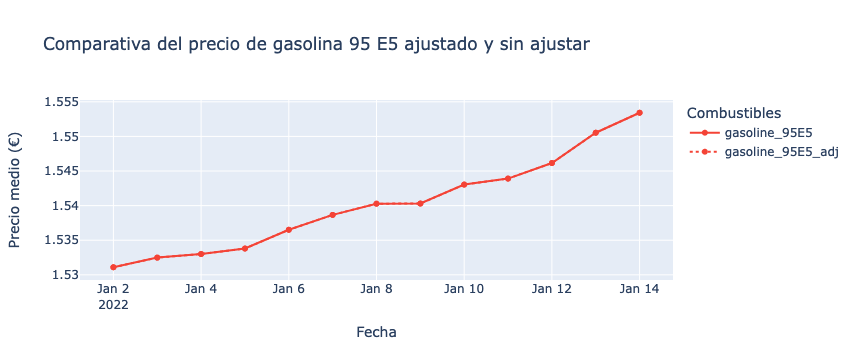

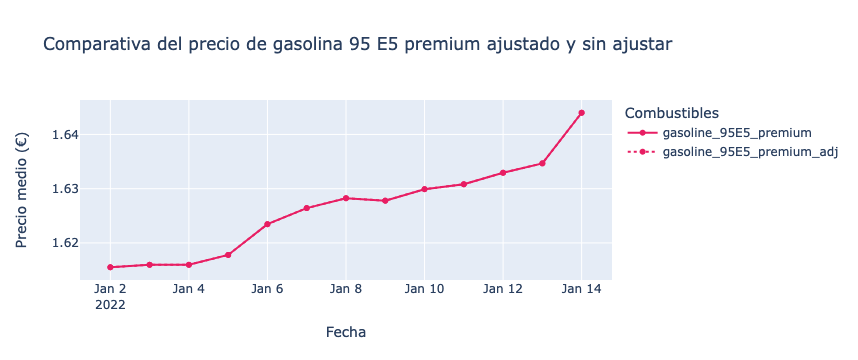

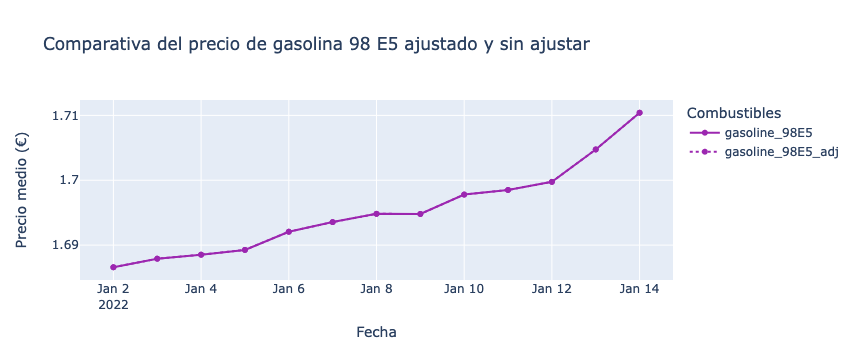

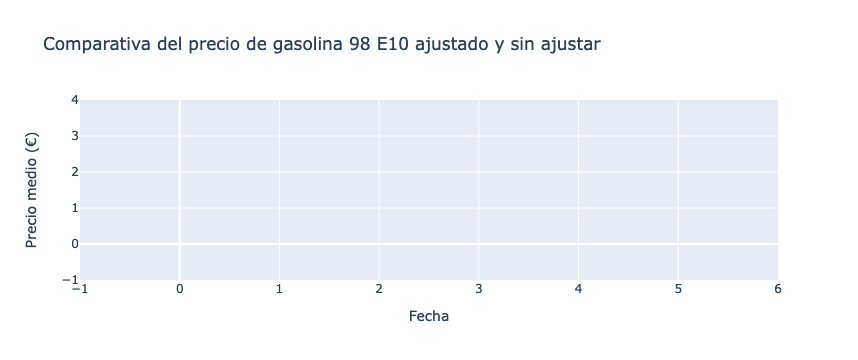

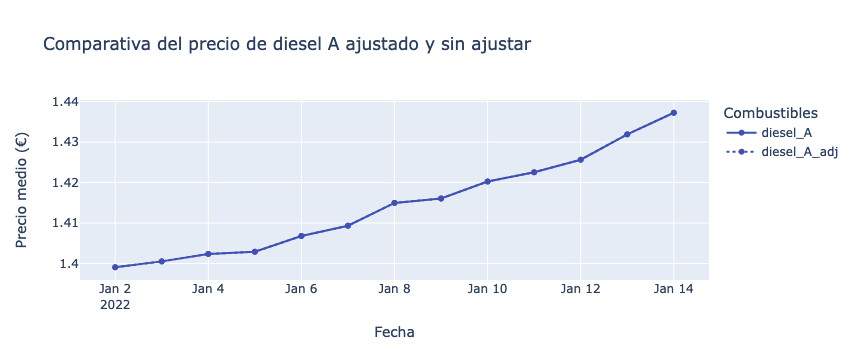

...

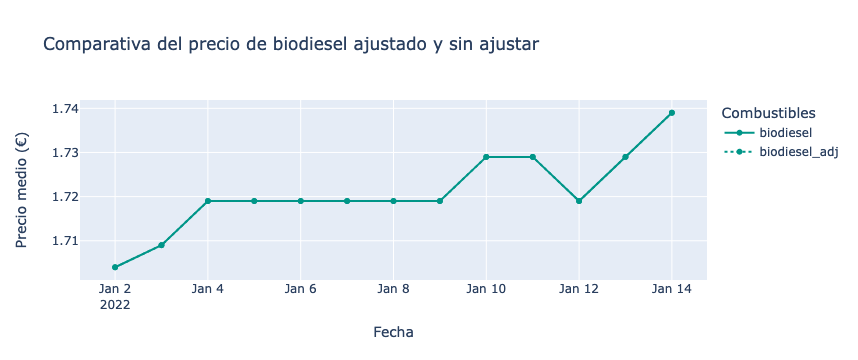

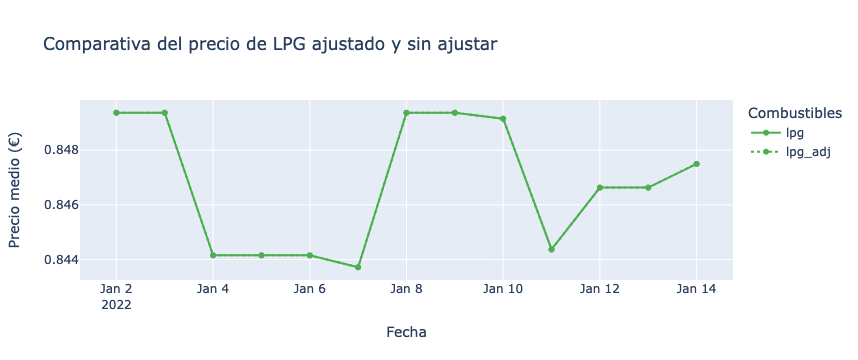

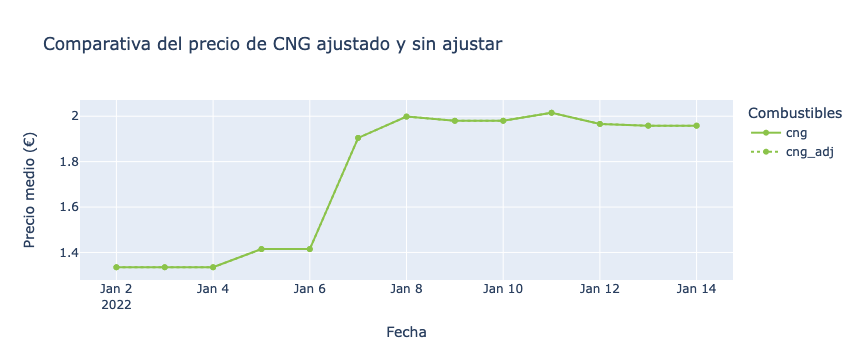

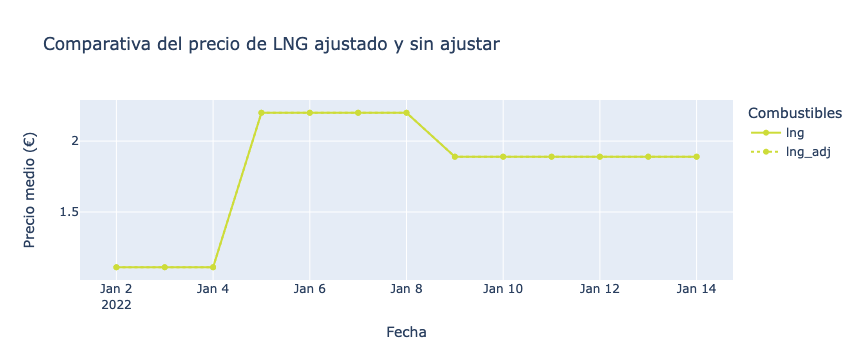

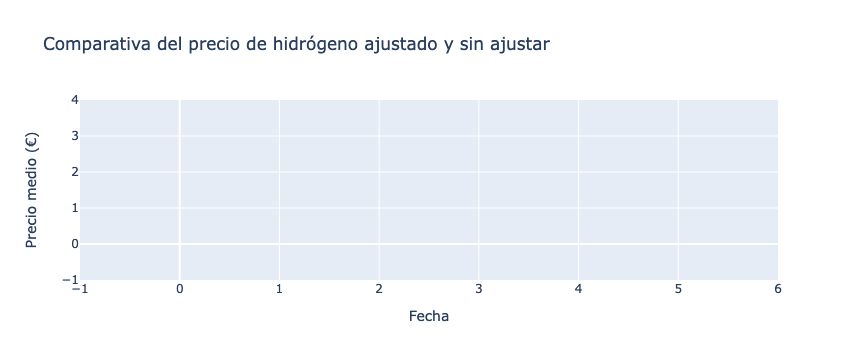

In [9]:

for i in range(len(products)):
    df_lineas = dict_df_products[products[i]][['date', products[i], products_adj[i]]]
    #Realizamos una media por fecha del precio del combustible en todas las gasolineras.
    df_lineas = df_lineas.groupby(['date'], group_keys = True).mean().reset_index()
    
    fig = px.line(df_lineas,
                  x='date', 
                  y=[products[i], products_adj[i]], 
                  labels={
                    "value": "Precio medio (€)",
                    "date": "Fecha",
                    "variable": "Combustibles"
                  },
                  title="Comparativa del precio de " + products_titles[products[i]] + " ajustado y sin ajustar",
                  color_discrete_sequence = [palette[i]])
        
    fig.update_traces(patch={"line": {"dash": 'dot'}}, selector={"legendgroup": products_adj[i]})
    fig.update_traces(mode="markers+lines", hovertemplate=None)
    fig.update_layout(hovermode="x unified")
    
    fig.show()



### Gráfico de lineas de la comparativa entre los precios ajustados de los combustibles

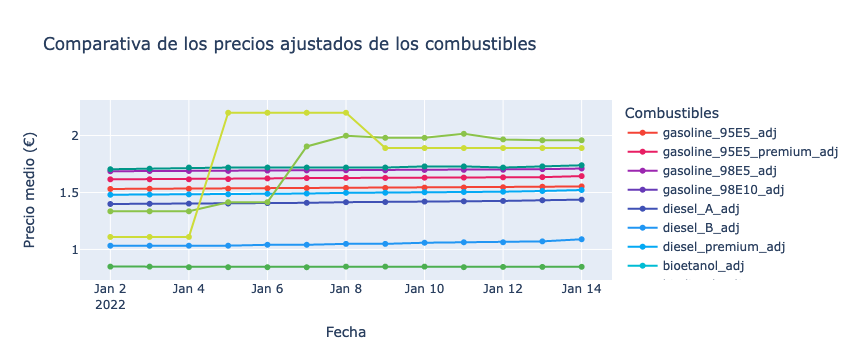

In [10]:
df_lineas = df_parsed[['date'] + products_adj].replace(0, np.nan)

df_lineas = df_lineas.groupby(['date'], group_keys = True).mean().reset_index()

fig = px.line(df_lineas, 
              x = 'date', 
              y = products_adj, 
              color_discrete_sequence = palette, 
              labels = {
                    "value": "Precio medio (€)",
                    "date": "Fecha",
                    "variable": "Combustibles"},
              title="Comparativa de los precios ajustados de los combustibles")

fig.update_traces(patch = {"line": {"dash": 'dot'}}, selector={"legendgroup": products_adj[i]})
fig.update_traces(mode = "markers+lines", hovertemplate=None)
fig.update_layout(hovermode = "x unified")

fig.show()

### Piechart del reparto de gasolineras por empresa

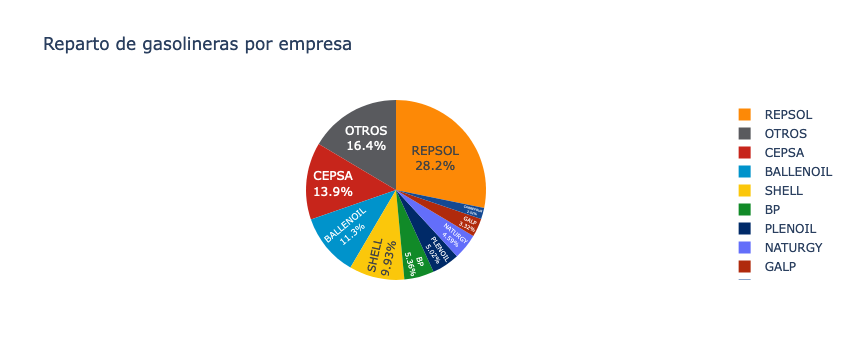

In [11]:
last_date=max(df_parsed['date'])
fig = px.pie(df_parsed[df_parsed['date'] == last_date], 
             values = 'station_id', 
             names = 'name_parsed', 
             title = 'Reparto de gasolineras por empresa', 
             color = 'name_parsed',
             labels = {'name_parsed':'Company',
                    'station_id':'Gasolineras'},
             color_discrete_map = name_colors)
fig.update_traces(textposition='inside', textinfo = 'percent+label')
fig.show()

In [12]:
# Adaptamos city border para marcar el contorno de la ciudad de Madrid
city_border['features'][0]['geometry'] = city_border['features'][0].copy()
city_border['features'][0]['type'] = "Feature"
city_border['features'][0]['id'] = "Madrid"
del city_border['features'][0]['coordinates']

### Mapa con la distribución de las gasolinearas por empresa

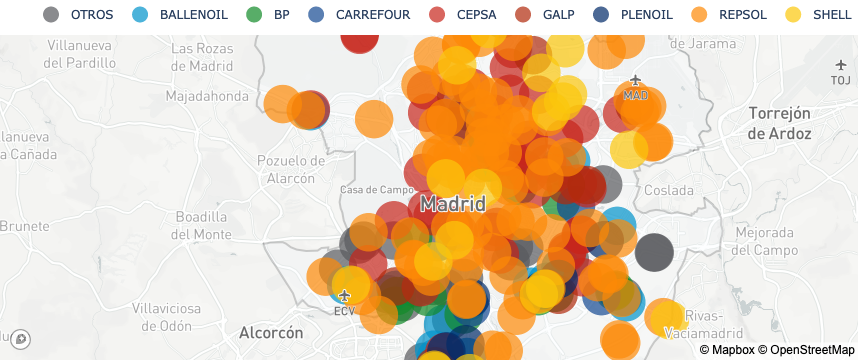

In [13]:
import plotly.graph_objects as go

#Hago copia para no cargarme el original
df_mapa = df_parsed.copy()

#Unicamente cogemos los datos para la primera fecha
df_mapa = df_mapa.sort_values(['station_id', 'date'], ascending=False).groupby('station_id', as_index=False).first() 

#Necesario para algunas funciones de Scattermapbox
mapbox_access_token = 'pk.eyJ1IjoiZWlzZW5oZXJyIiwiYSI6ImNsYXByaWNqajEzOHAzeG4wYTV6NDZ4aDIifQ.oGCZPVxl5y6Zyg8MJWTypQ'

fig = go.Figure()
fig.add_trace(go.Choroplethmapbox(geojson = city_border, locations=["Madrid"], 
                                    z = [0],
                                    colorscale = "Blues", 
                                    zmin = 0, 
                                    zmax = max(df_mapa.groupby("neighbourhood",as_index = False).count()['station_id']),
                                    showscale=False,
                                      marker_opacity = 0.25, 
                                    marker_line_width=2))

for name in list(name_colors.keys()):
    df_mapa_1 = df_mapa[df_mapa['name_parsed'] == name]
    fig.add_trace(go.Scattermapbox(
        name = name,
        mode = "markers+text",
        lat = df_mapa_1["latitude"], lon = df_mapa_1["longitude"],
        marker = go.scattermapbox.Marker(
                size = df_mapa['num_combustibles'] * 3,
                symbol = "circle",
                color = name_colors[name],
                opacity = 0.7)
        ))
      
fig.update_layout(mapbox_style = "open-street-map",
                  margin = {"r":0,"t":0,"l":0,"b":0},
                  mapbox = dict(accesstoken = mapbox_access_token,
                              center = dict(lat = 40.42, lon = -3.72),
                              style = 'light',
                              zoom = 10),
                 legend=dict(
                          orientation="h",
                          yanchor="bottom",
                          y=1.02,
                          xanchor="right",
                          x=1
                      ))

fig.show();



### Mapa con la densidad de gasolineras por barrio de Madrid

In [14]:
## Modificamos nuestro .geojson
for i in range(len(neighbourhood_borders['features'])):
    neighbourhood_borders['features'][i]['geometry']=neighbourhood_borders['features'][i].copy()
    neighbourhood_borders['features'][i]['type']="Feature"
    neighbourhood_borders['features'][i]['id']=neighbourhood_names.loc[i, 'Name']
    del neighbourhood_borders['features'][i]['coordinates']

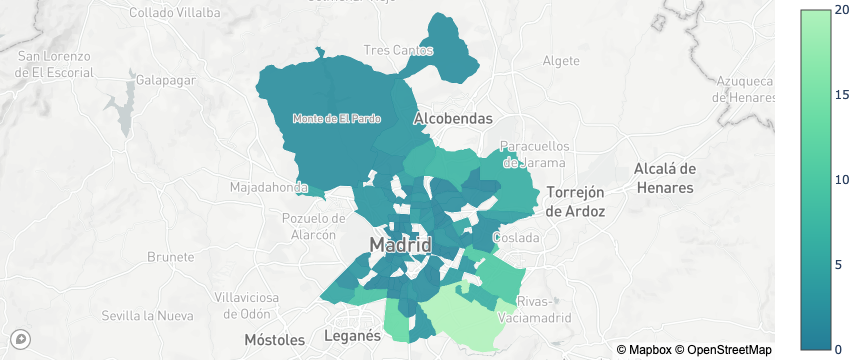

In [15]:
#Hago copia para no cargarme el original
df_mapa = df_parsed.copy()
#Voy a coger la ultima fecha de cada gasolinera para solo pintar un punto
df_mapa = df_mapa.sort_values(['station_id', 'date'], ascending = False).groupby('station_id', as_index = False).first()

fig = go.Figure(go.Choroplethmapbox(geojson=neighbourhood_borders, locations=np.sort(df_mapa.neighbourhood.unique()), 
                                    z = df_mapa.groupby("neighbourhood",as_index = False).count()['station_id'],
                                    colorscale = "tealgrn_r", 
                                    zmin = 0, 
                                    zmax = max(df_mapa.groupby("neighbourhood",as_index = False).count()['station_id']),
                                    marker_opacity = 0.9, marker_line_width=0))

fig.update_layout(mapbox_style = "open-street-map",
                  margin = {"r":0,"t":0,"l":0,"b":0},
                  mapbox = dict(accesstoken = mapbox_access_token,
                              center=dict(lat=40.48, lon = -3.72),
                              style = 'light',
                              zoom = 9.1))
fig.show();

### Mapa con la densidad de gasolineras por barrio de Madrid por combustible

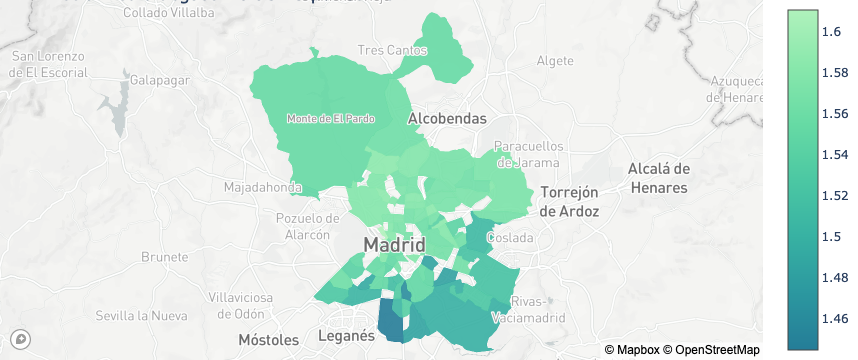

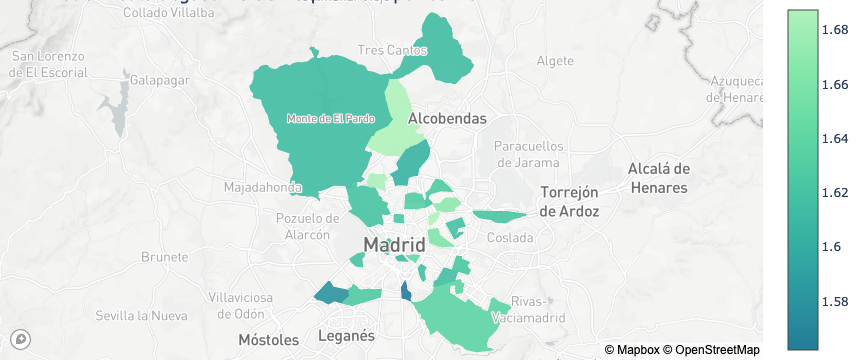

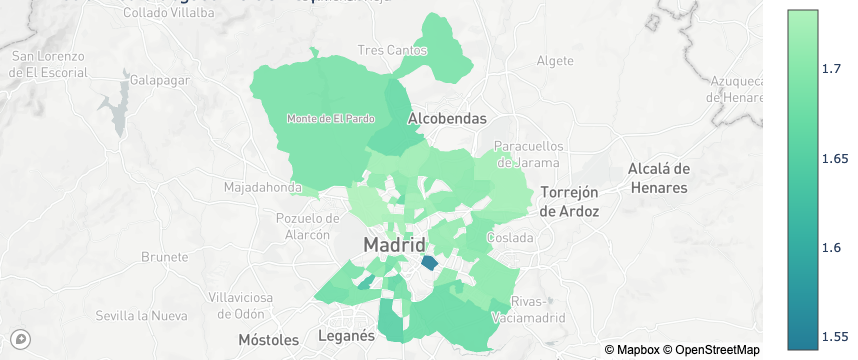

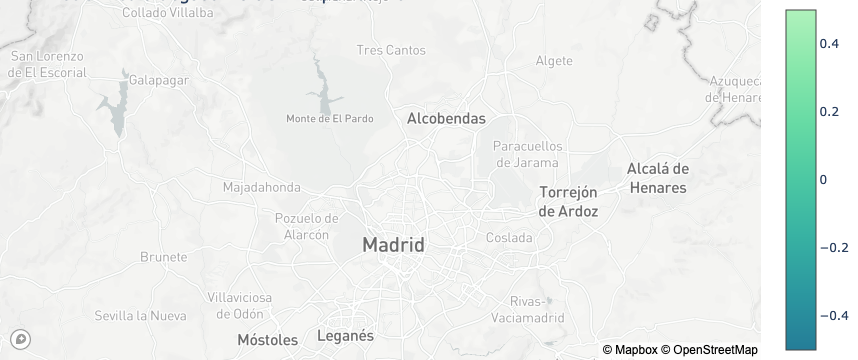

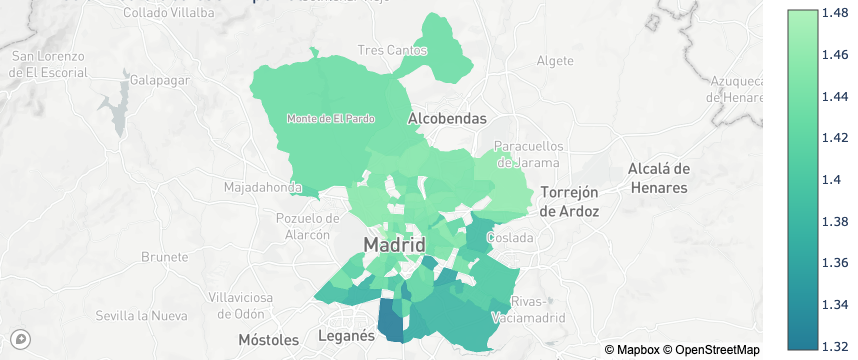

...

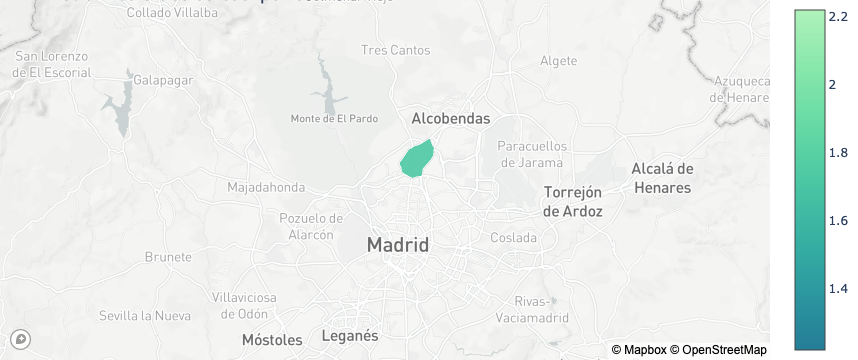

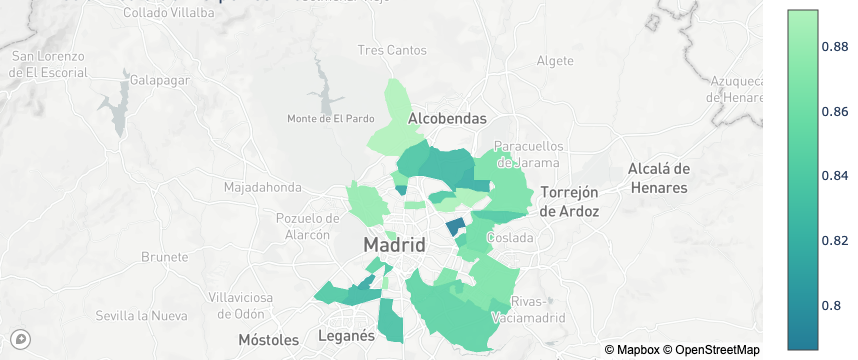

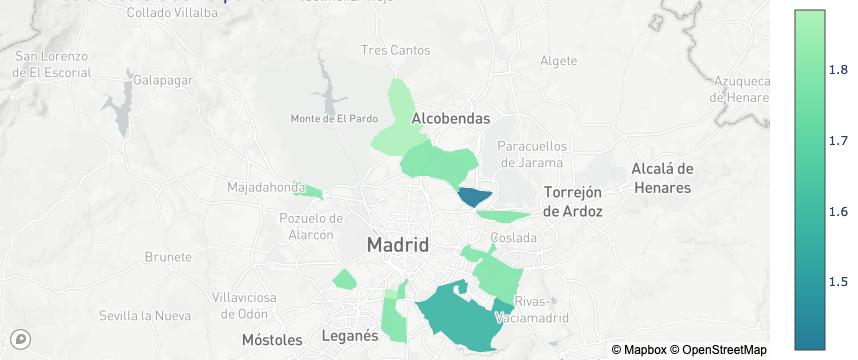

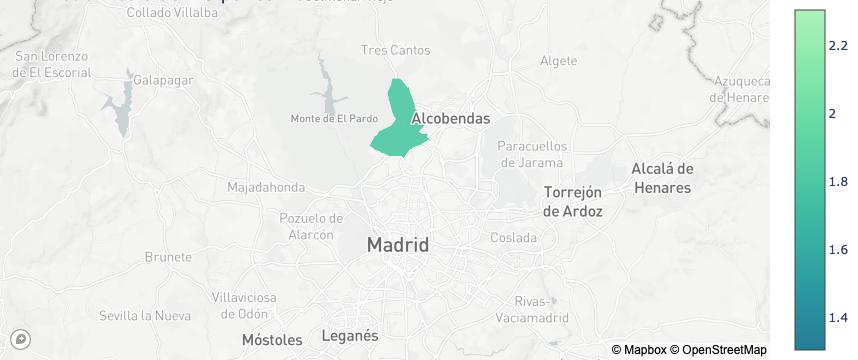

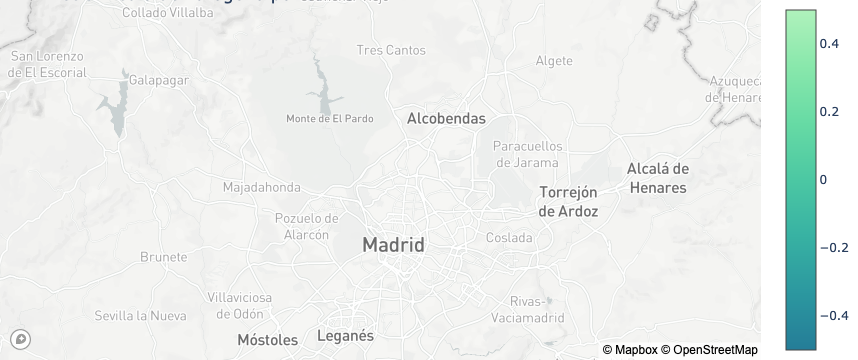

In [16]:
# Elegimos un rango de fechas
date_init = datetime(2022,1,1)
date_end = datetime(2022,1,15)

#Hago copia para no cargarme el original
df_mapa = df_parsed.copy()
df_mapa = df_parsed.replace(0, np.nan)
df_mapa = df_mapa[(df_mapa['date'] > date_init) & (df_mapa['date'] < date_end)]

dct = {
    'number': 'mean',
    'object': lambda col: col.mode() if col.nunique() == 1 else np.nan,
}

#https://stackoverflow.com/questions/71209488/pandas-dataframe-groupby-mean-including-string-columns
groupby_cols = ['station_id','neighbourhood']
dct = {k: v for i in [{col: agg for col in df_mapa.select_dtypes(tp).columns.difference(groupby_cols)} for tp, agg in dct.items()] for k, v in i.items()}
df_mapa = df_mapa.groupby(groupby_cols,as_index=False).agg(**{k: (k, v) for k, v in dct.items()})

for product in products:
    fig = go.Figure(go.Choroplethmapbox(geojson = neighbourhood_borders, locations = np.sort(df_mapa.neighbourhood.unique()), 
                                        z=df_mapa.groupby("neighbourhood",as_index = False).mean()[product],
                                        colorscale = "tealgrn_r", 
                                        zmin = min(df_mapa.groupby("neighbourhood",as_index = False).mean()[product]), 
                                        zmax = max(df_mapa.groupby("neighbourhood",as_index = False).mean()[product]),
                                        marker_opacity = 0.9, marker_line_width = 0))

    fig.update_layout(mapbox_style = "open-street-map",
                      margin = {"r":0,"t":0,"l":0,"b":0},
                      mapbox = dict(accesstoken = mapbox_access_token,
                                  center = dict(lat = 40.48, lon = -3.72),
                                  style = 'light',
                                  zoom = 9.1),
                     title="Precio medio de" + products_titles[product] + " por barrio")
    
    fig.show();


### Gráfico de violin con el precio de los combustibles.

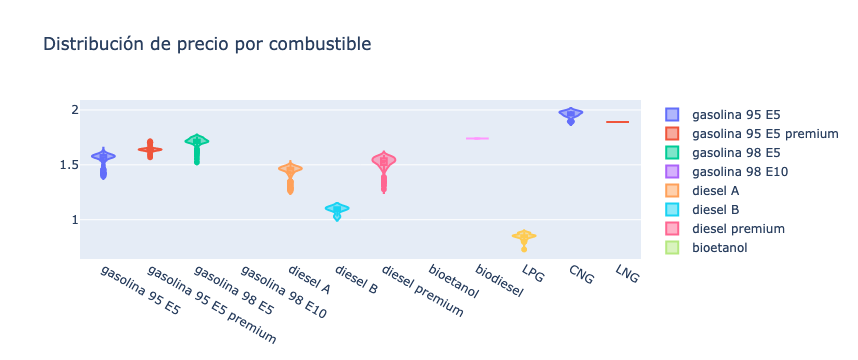

In [17]:
df_violin = df_parsed.copy()
df_violin = df_violin.replace(0, np.nan)
df_violin = df_violin.sort_values(['station_id', 'date'], ascending = False).groupby('station_id', as_index = False).first()
df_violin = df_violin[['date'] + products]

fig = go.Figure()

for product in products:
    fig.add_trace(go.Violin(y = df_violin[product],
                            name = products_titles[product],
                            box_visible = True,
                            meanline_visible = True ))

fig.update_layout(title_text="Distribución de precio por combustible", yaxis_zeroline=True)
fig.show()


### Gráfico de violin con el precio del combustible por empresa.

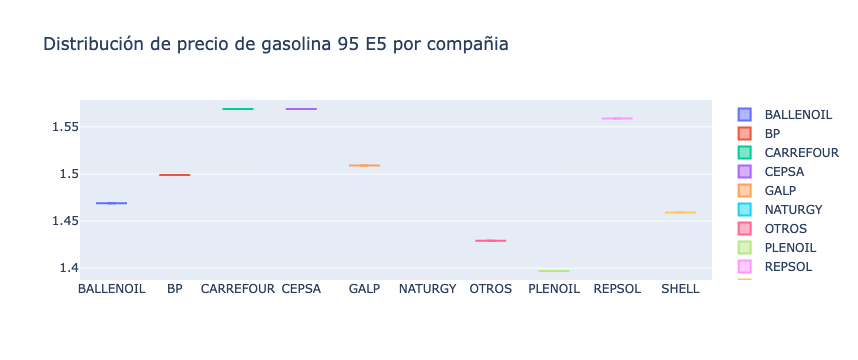

In [18]:
product = products[0]
df_violin = df_parsed.copy()

df_violin = df_violin.replace(0, np.nan)
df_violin = df_violin.sort_values(['station_id', 'date'], ascending = False).groupby('name_parsed', as_index = False).first()
df_violin = df_violin[['date'] + products + ['name_parsed']]


fig = go.Figure()

for company in df_violin['name_parsed']:
    fig.add_trace(go.Violin(
                            y = df_violin[df_violin['name_parsed']==company][product],
                            name = company,
                            box_visible = True,
                            meanline_visible = True ))
fig.update_layout(title_text="Distribución de precio de " + products_titles[product] + " por compañia", yaxis_zeroline=True)
fig.show()

### Scatter-plot precio del combustible en función de la distancia a la gasolinera más cercana

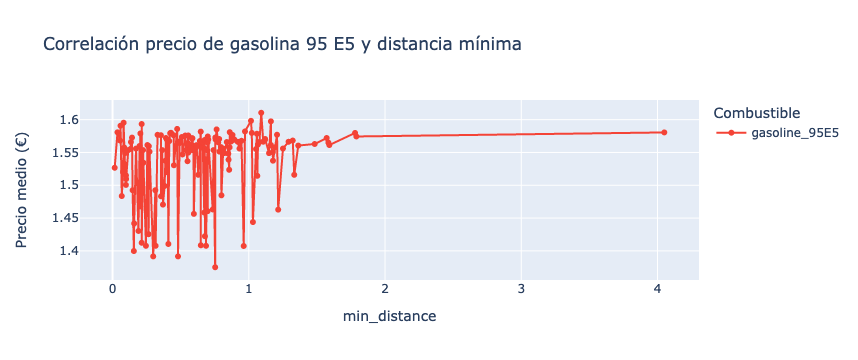

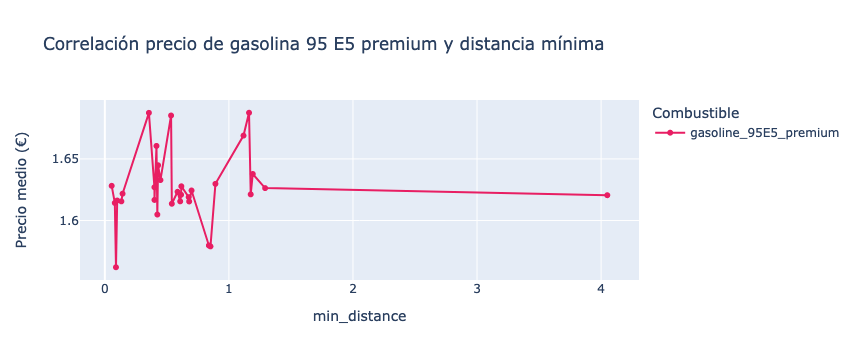

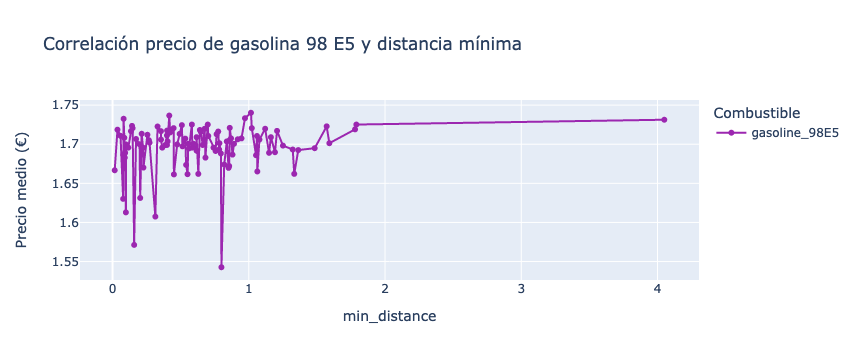

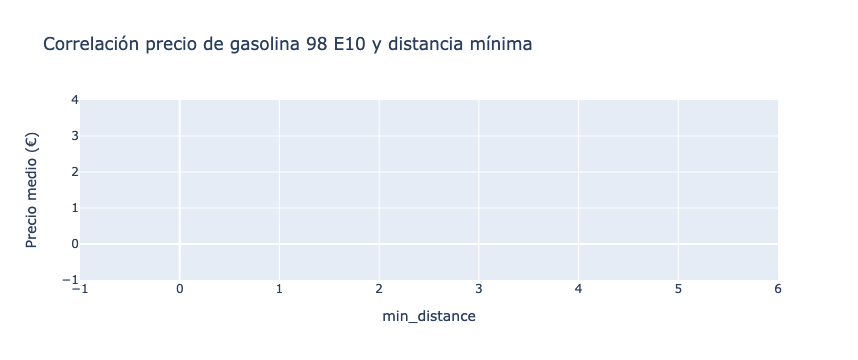

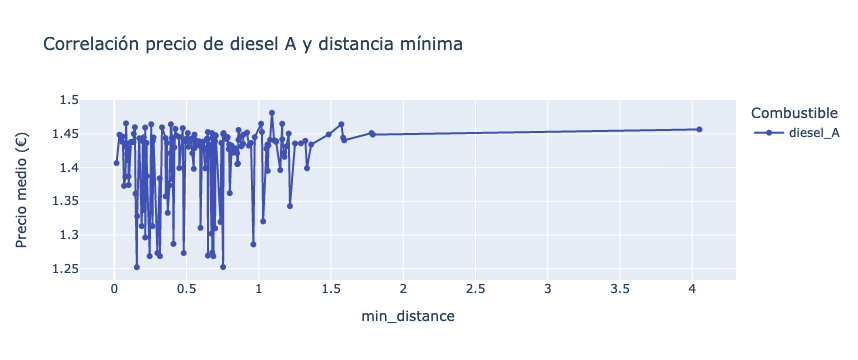

...

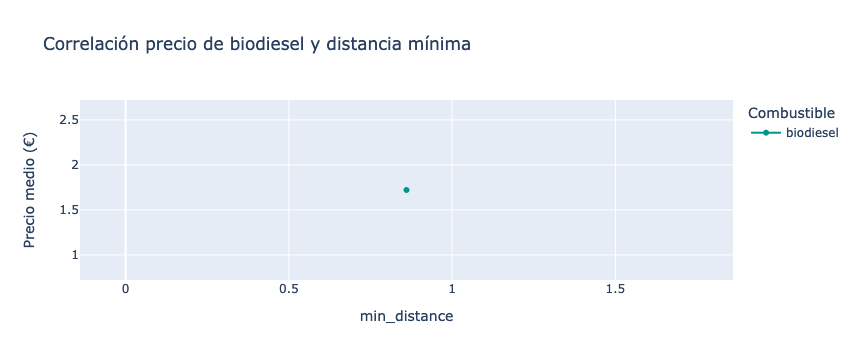

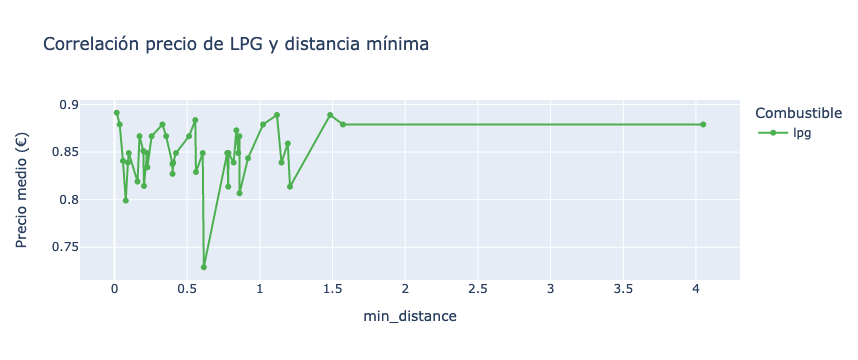

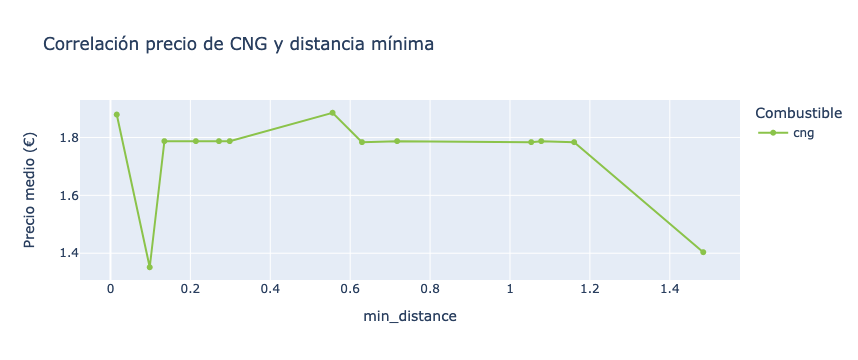

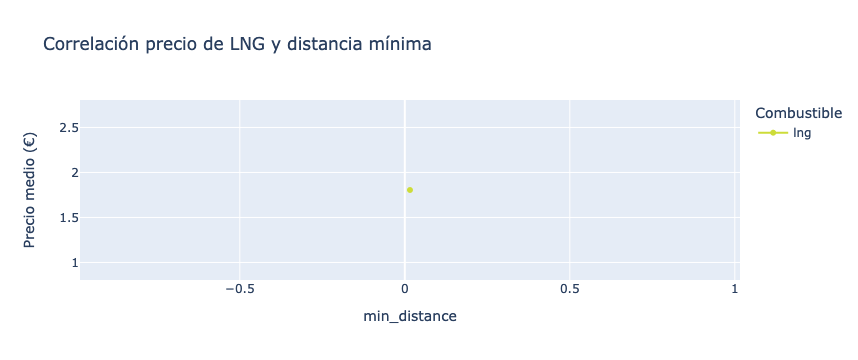

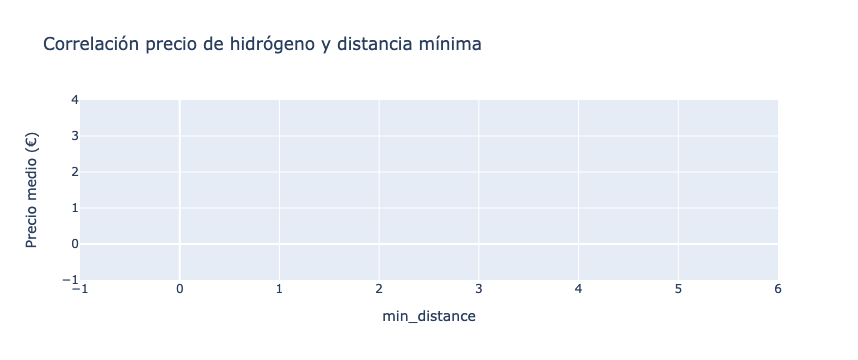

In [19]:
i=0
for product in products:
    df_lineas = dict_df_products[product][['min_distance', product]]
    #Realizamos una media por fecha del precio del combustible en todas las gasolineras.
    df_lineas = df_lineas.groupby(['min_distance'], group_keys = True).mean().reset_index() 

    fig = px.line(df_lineas, 
                  x = 'min_distance', 
                  y = [product], 
                  color_discrete_sequence = [palette[i]], 
                  labels = {
                    "value": "Precio medio (€)",
                    "date": "Distancia Mínima",
                    "variable": "Combustible"
                  },
                  title = 'Correlación precio de '+ products_titles[product] + ' y distancia mínima')
    
    fig.update_traces(mode = "markers+lines", hovertemplate=None)
    fig.update_layout(hovermode = "x")
    
    fig.show()
    i=i+1


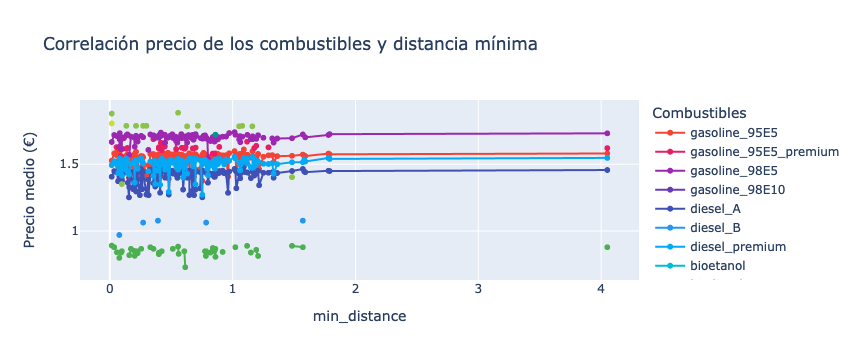

In [20]:
df_lineas = df_parsed[['min_distance'] + products].replace(0, np.nan)

df_lineas = df_lineas.groupby(['min_distance'], group_keys = True).mean().reset_index()

fig = px.line(df_lineas, 
              x='min_distance', 
              y= products, 
              color_discrete_sequence = palette, 
              labels={
                    "value": "Precio medio (€)",
                    "date": "Fecha",
                    "variable": "Combustibles"
                  },
              title="Correlación precio de los combustibles y distancia mínima")

fig.update_traces(mode="markers+lines", hovertemplate=None)
fig.update_layout(hovermode="x unified")

fig.show()